In [1]:
# Import all of our data science tools!

from PIL import Image
import pandas as pd
import numpy as np
import pandas_profiling
import scipy

import matplotlib.pyplot as plt
import missingno
import seaborn as sns
plt.style.use('seaborn-whitegrid')

from sklearn.preprocessing import OneHotEncoder, LabelEncoder, label_binarize

from sklearn.model_selection import train_test_split
from sklearn import model_selection, tree, preprocessing, metrics, linear_model
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDClassifier
from sklearn.tree import DecisionTreeClassifier

import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import missingno
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('~/Downloads/superconduct/train.csv')
df.head()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,2.257143,2.213364,2.219783,1.368922,1.066221,1,1.085714,0.433013,0.437059,29.0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,2.257143,1.888175,2.210679,1.557113,1.047221,2,1.128571,0.632456,0.468606,26.0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,2.271429,2.213364,2.232679,1.368922,1.029175,1,1.114286,0.433013,0.444697,19.0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,2.264286,2.213364,2.226222,1.368922,1.048834,1,1.100000,0.433013,0.440952,22.0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,2.242857,2.213364,2.206963,1.368922,1.096052,1,1.057143,0.433013,0.428809,23.0


In [3]:
pandas_profiling.ProfileReport(df)

In [4]:
elements = pd.read_csv('~/Downloads/superconduct/unique_m.csv')
elements.head()

,H,He,Li,Be,B,C,N,O,F,Ne,...,Au,Hg,Tl,Pb,Bi,Po,At,Rn,critical_temp,material
0,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,29.0,Ba0.2La1.8Cu1O4
1,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,26.0,Ba0.1La1.9Ag0.1Cu0.9O4
2,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,19.0,Ba0.1La1.9Cu1O4
3,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,22.0,Ba0.15La1.85Cu1O4
4,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,23.0,Ba0.3La1.7Cu1O4


In [5]:
pandas_profiling.ProfileReport(elements)

In [6]:
# Split the data into groups
num_elements = df.iloc[:,0]
atomic_mass = df.iloc[:,1:11]
fie = df.iloc[:,11:21]
atomic_radius = df.iloc[:,21:31]
density = df.iloc[:,31:41]
electron_affinity = df.iloc[:,41:51]
fusion_heat = df.iloc[:,51:61]
thermal_conductivity = df.iloc[:,61:71]
valence = df.iloc[:,71:81]
critical_temp = df.iloc[:,-1]

## Q: What's the relationship between number of elements and critical temperature?

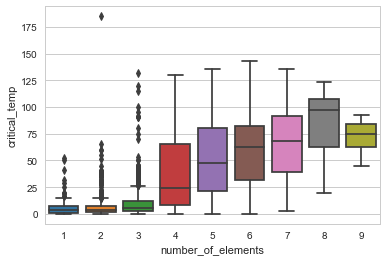

In [7]:
sns.boxplot(x = num_elements, y = critical_temp)

## Q: Which feature is most correlated with critical temperature?

### Atomic Mass

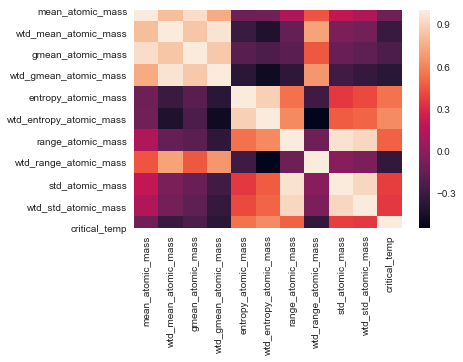

In [8]:
sns.heatmap(pd.concat([atomic_mass, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([atomic_mass, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([atomic_mass, critical_temp], axis = 1).columns)

In [9]:
pd.concat([atomic_mass, critical_temp], axis = 1).corr()

,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,wtd_std_atomic_mass,critical_temp
mean_atomic_mass,1.000000,0.815977,0.940298,0.745841,-0.104000,-0.097609,0.125659,0.446225,0.196460,0.130675,-0.113523
wtd_mean_atomic_mass,0.815977,1.000000,0.848242,0.964085,-0.308046,-0.412666,-0.144029,0.716623,-0.060739,-0.089471,-0.312272
gmean_atomic_mass,0.940298,0.848242,1.000000,0.856975,-0.190214,-0.232183,-0.175861,0.458473,-0.121708,-0.166042,-0.230345
wtd_gmean_atomic_mass,0.745841,0.964085,0.856975,1.000000,-0.370561,-0.484664,-0.352093,0.673326,-0.274487,-0.331657,-0.369858
entropy_atomic_mass,-0.104000,-0.308046,-0.190214,-0.370561,1.000000,0.889709,0.538774,-0.284941,0.357951,0.413647,0.543619
wtd_entropy_atomic_mass,-0.097609,-0.412666,-0.232183,-0.484664,0.889709,1.000000,0.624432,-0.543305,0.474542,0.495970,0.626930
range_atomic_mass,0.125659,-0.144029,-0.175861,-0.352093,0.538774,0.624432,1.000000,-0.109804,0.960854,0.918152,0.491970
wtd_range_atomic_mass,0.446225,0.716623,0.458473,0.673326,-0.284941,-0.543305,-0.109804,1.000000,-0.017979,-0.063091,-0.337131
std_atomic_mass,0.196460,-0.060739,-0.121708,-0.274487,0.357951,0.474542,0.960854,-0.017979,1.000000,0.919788,0.378766
wtd_std_atomic_mass,0.130675,-0.089471,-0.166042,-0.331657,0.413647,0.495970,0.918152,-0.063091,0.919788,1.000000,0.359306


### FIE

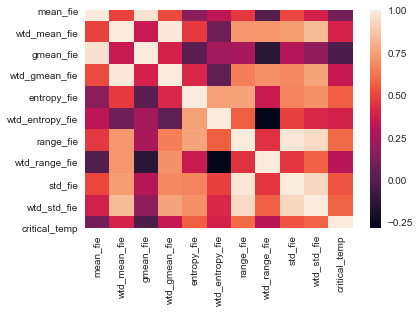

In [10]:
sns.heatmap(pd.concat([fie, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([fie, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([fie, critical_temp], axis = 1).columns)

In [11]:
pd.concat([fie, critical_temp], axis = 1).corr()

,mean_fie,wtd_mean_fie,gmean_fie,wtd_gmean_fie,entropy_fie,wtd_entropy_fie,range_fie,wtd_range_fie,std_fie,wtd_std_fie,critical_temp
mean_fie,1.000000,0.497910,0.969325,0.517754,0.163814,0.316151,0.468192,-0.008830,0.505927,0.388493,0.102268
wtd_mean_fie,0.497910,1.000000,0.350522,0.992331,0.473299,0.079944,0.727474,0.724828,0.744395,0.835451,0.398796
gmean_fie,0.969325,0.350522,1.000000,0.390305,0.022931,0.238852,0.254210,-0.137469,0.286583,0.182979,-0.025103
wtd_gmean_fie,0.517754,0.992331,0.390305,1.000000,0.414421,0.030222,0.659216,0.711316,0.680330,0.765892,0.343747
entropy_fie,0.163814,0.473299,0.022931,0.414421,1.000000,0.753362,0.767796,0.353513,0.672087,0.708893,0.567817
wtd_entropy_fie,0.316151,0.079944,0.238852,0.030222,0.753362,1.000000,0.565623,-0.280675,0.490948,0.411288,0.388359
range_fie,0.468192,0.727474,0.254210,0.659216,0.767796,0.565623,1.000000,0.446949,0.981628,0.940281,0.600790
wtd_range_fie,-0.008830,0.724828,-0.137469,0.711316,0.353513,-0.280675,0.446949,1.000000,0.460725,0.576880,0.300482
std_fie,0.505927,0.744395,0.286583,0.680330,0.672087,0.490948,0.981628,0.460725,1.000000,0.934255,0.541804
wtd_std_fie,0.388493,0.835451,0.182979,0.765892,0.708893,0.411288,0.940281,0.576880,0.934255,1.000000,0.582013


### Atomic Radius

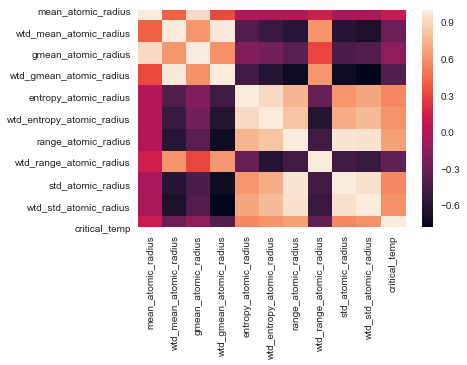

In [12]:
sns.heatmap(pd.concat([atomic_radius, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([atomic_radius, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([atomic_radius, critical_temp], axis = 1).columns)

In [13]:
pd.concat([atomic_radius, critical_temp], axis = 1).corr()

,mean_atomic_radius,wtd_mean_atomic_radius,gmean_atomic_radius,wtd_gmean_atomic_radius,entropy_atomic_radius,wtd_entropy_atomic_radius,range_atomic_radius,wtd_range_atomic_radius,std_atomic_radius,wtd_std_atomic_radius,critical_temp
mean_atomic_radius,1.000000,0.405796,0.915931,0.324076,0.016810,0.007859,0.006072,0.131157,-0.040941,-0.029068,0.105273
wtd_mean_atomic_radius,0.405796,1.000000,0.616773,0.980107,-0.399138,-0.518036,-0.593646,0.608917,-0.603936,-0.655905,-0.297272
gmean_atomic_radius,0.915931,0.616773,1.000000,0.591474,-0.208134,-0.260587,-0.371154,0.306511,-0.421971,-0.395039,-0.143770
wtd_gmean_atomic_radius,0.324076,0.980107,0.591474,1.000000,-0.490130,-0.611495,-0.719385,0.621441,-0.718061,-0.783656,-0.405176
entropy_atomic_radius,0.016810,-0.399138,-0.208134,-0.490130,1.000000,0.914223,0.744782,-0.314141,0.610407,0.679566,0.558937
wtd_entropy_atomic_radius,0.007859,-0.518036,-0.260587,-0.611495,0.914223,1.000000,0.812398,-0.614870,0.709369,0.781488,0.603494
range_atomic_radius,0.006072,-0.593646,-0.371154,-0.719385,0.744782,0.812398,1.000000,-0.485248,0.967428,0.958004,0.653759
wtd_range_atomic_radius,0.131157,0.608917,0.306511,0.621441,-0.314141,-0.614870,-0.485248,1.000000,-0.463161,-0.523390,-0.344100
std_atomic_radius,-0.040941,-0.603936,-0.421971,-0.718061,0.610407,0.709369,0.967428,-0.463161,1.000000,0.944536,0.559629
wtd_std_atomic_radius,-0.029068,-0.655905,-0.395039,-0.783656,0.679566,0.781488,0.958004,-0.523390,0.944536,1.000000,0.599199


### Density

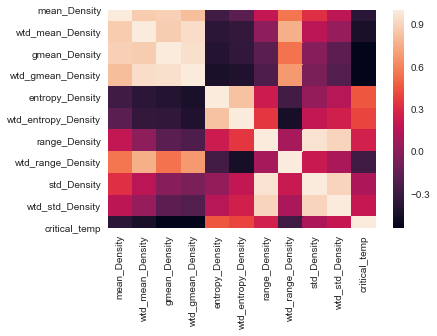

In [14]:
sns.heatmap(pd.concat([density, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([density, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([density, critical_temp], axis = 1).columns)

In [15]:
pd.concat([density, critical_temp], axis = 1).corr()

,mean_Density,wtd_mean_Density,gmean_Density,wtd_gmean_Density,entropy_Density,wtd_entropy_Density,range_Density,wtd_range_Density,std_Density,wtd_std_Density,critical_temp
mean_Density,1.000000,0.873309,0.889264,0.816792,-0.277462,-0.175222,0.194377,0.557437,0.325907,0.176206,-0.368262
wtd_mean_Density,0.873309,1.000000,0.876732,0.941502,-0.366664,-0.331441,0.008263,0.759135,0.163137,0.036701,-0.433940
gmean_Density,0.889264,0.876732,1.000000,0.951995,-0.397034,-0.338262,-0.178800,0.542907,-0.019343,-0.170079,-0.541684
wtd_gmean_Density,0.816792,0.941502,0.951995,1.000000,-0.435991,-0.410425,-0.223649,0.677573,-0.055641,-0.215255,-0.540046
entropy_Density,-0.277462,-0.366664,-0.397034,-0.435991,1.000000,0.833868,0.229467,-0.270296,0.032097,0.151244,0.457169
wtd_entropy_Density,-0.175222,-0.331441,-0.338262,-0.410425,0.833868,1.000000,0.353678,-0.448409,0.194999,0.257941,0.400190
range_Density,0.194377,0.008263,-0.178800,-0.223649,0.229467,0.353678,1.000000,0.095833,0.959956,0.907307,0.260536
wtd_range_Density,0.557437,0.759135,0.542907,0.677573,-0.270296,-0.448409,0.095833,1.000000,0.219414,0.104655,-0.284729
std_Density,0.325907,0.163137,-0.019343,-0.055641,0.032097,0.194999,0.959956,0.219414,1.000000,0.905669,0.115243
wtd_std_Density,0.176206,0.036701,-0.170079,-0.215255,0.151244,0.257941,0.907307,0.104655,0.905669,1.000000,0.207663


### Electron Affinity

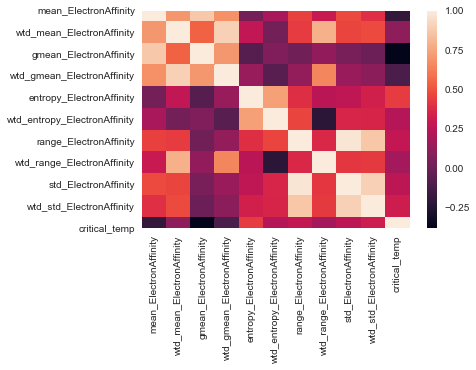

In [16]:
sns.heatmap(pd.concat([electron_affinity, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([electron_affinity, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([electron_affinity, critical_temp], axis = 1).columns)

In [17]:
pd.concat([electron_affinity, critical_temp], axis = 1).corr()

,mean_ElectronAffinity,wtd_mean_ElectronAffinity,gmean_ElectronAffinity,wtd_gmean_ElectronAffinity,entropy_ElectronAffinity,wtd_entropy_ElectronAffinity,range_ElectronAffinity,wtd_range_ElectronAffinity,std_ElectronAffinity,wtd_std_ElectronAffinity,critical_temp
mean_ElectronAffinity,1.000000,0.708784,0.874785,0.685333,0.034300,0.191701,0.446312,0.303645,0.478426,0.401339,-0.193550
wtd_mean_ElectronAffinity,0.708784,1.000000,0.545819,0.899739,0.274190,0.028555,0.434528,0.793244,0.463680,0.477634,0.111516
gmean_ElectronAffinity,0.874785,0.545819,1.000000,0.708419,-0.072366,0.063029,0.019404,0.124783,0.040489,-0.000409,-0.380568
wtd_gmean_ElectronAffinity,0.685333,0.899739,0.708419,1.000000,0.145660,-0.067749,0.128751,0.654282,0.151079,0.101151,-0.107359
entropy_ElectronAffinity,0.034300,0.274190,-0.072366,0.145660,1.000000,0.735703,0.394142,0.251469,0.269397,0.336378,0.437207
wtd_entropy_ElectronAffinity,0.191701,0.028555,0.063029,-0.067749,0.735703,1.000000,0.465239,-0.220289,0.358528,0.353035,0.237648
range_ElectronAffinity,0.446312,0.434528,0.019404,0.128751,0.394142,0.465239,1.000000,0.369598,0.973114,0.865972,0.279705
wtd_range_ElectronAffinity,0.303645,0.793244,0.124783,0.654282,0.251469,-0.220289,0.369598,1.000000,0.418118,0.429653,0.185348
std_ElectronAffinity,0.478426,0.463680,0.040489,0.151079,0.269397,0.358528,0.973114,0.418118,1.000000,0.898325,0.262103
wtd_std_ElectronAffinity,0.401339,0.477634,-0.000409,0.101151,0.336378,0.353035,0.865972,0.429653,0.898325,1.000000,0.315147


### Fusion Heat

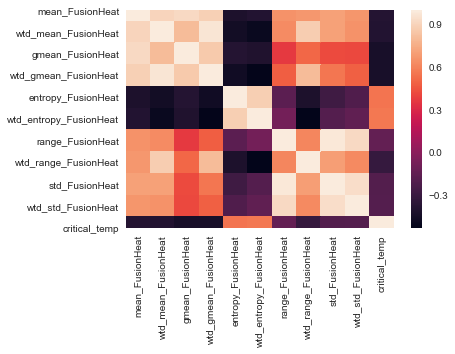

In [18]:
sns.heatmap(pd.concat([fusion_heat, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([fusion_heat, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([fusion_heat, critical_temp], axis = 1).columns)

In [19]:
pd.concat([fusion_heat, critical_temp], axis = 1).corr()

,mean_FusionHeat,wtd_mean_FusionHeat,gmean_FusionHeat,wtd_gmean_FusionHeat,entropy_FusionHeat,wtd_entropy_FusionHeat,range_FusionHeat,wtd_range_FusionHeat,std_FusionHeat,wtd_std_FusionHeat,critical_temp
mean_FusionHeat,1.000000,0.909575,0.926769,0.888951,-0.417471,-0.391070,0.657908,0.676468,0.710846,0.667983,-0.385509
wtd_mean_FusionHeat,0.909575,1.000000,0.810803,0.970948,-0.454927,-0.492835,0.631659,0.876764,0.706765,0.657767,-0.394117
gmean_FusionHeat,0.926769,0.810803,1.000000,0.866226,-0.388032,-0.405306,0.368632,0.509389,0.424393,0.417071,-0.431795
wtd_gmean_FusionHeat,0.888951,0.970948,0.866226,1.000000,-0.465400,-0.521815,0.480426,0.812866,0.559906,0.489577,-0.432365
entropy_FusionHeat,-0.417471,-0.454927,-0.388032,-0.465400,1.000000,0.881655,-0.171671,-0.416650,-0.280592,-0.212938,0.552709
wtd_entropy_FusionHeat,-0.391070,-0.492835,-0.405306,-0.521815,0.881655,1.000000,-0.082402,-0.532524,-0.196669,-0.151788,0.563244
range_FusionHeat,0.657908,0.631659,0.368632,0.480426,-0.171671,-0.082402,1.000000,0.614010,0.984574,0.925642,-0.140714
wtd_range_FusionHeat,0.676468,0.876764,0.509389,0.812866,-0.416650,-0.532524,0.614010,1.000000,0.700427,0.625004,-0.314178
std_FusionHeat,0.710846,0.706765,0.424393,0.559906,-0.280592,-0.196669,0.984574,0.700427,1.000000,0.940183,-0.201310
wtd_std_FusionHeat,0.667983,0.657767,0.417071,0.489577,-0.212938,-0.151788,0.925642,0.625004,0.940183,1.000000,-0.195571


### Thermal Conductivity

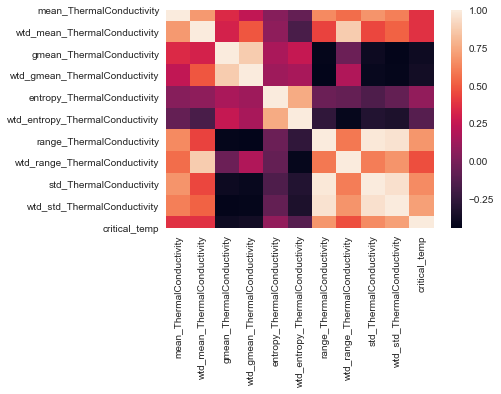

In [20]:
sns.heatmap(pd.concat([thermal_conductivity, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([thermal_conductivity, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([thermal_conductivity, critical_temp], axis = 1).columns)

In [21]:
pd.concat([thermal_conductivity, critical_temp], axis = 1).corr()

,mean_ThermalConductivity,wtd_mean_ThermalConductivity,gmean_ThermalConductivity,wtd_gmean_ThermalConductivity,entropy_ThermalConductivity,wtd_entropy_ThermalConductivity,range_ThermalConductivity,wtd_range_ThermalConductivity,std_ThermalConductivity,wtd_std_ThermalConductivity,critical_temp
mean_ThermalConductivity,1.000000,0.696822,0.348204,0.242594,0.044425,-0.066129,0.648715,0.557421,0.679575,0.612204,0.375813
wtd_mean_ThermalConductivity,0.696822,1.000000,0.316827,0.490187,0.076259,-0.163613,0.435938,0.876294,0.446268,0.523343,0.379336
gmean_ThermalConductivity,0.348204,0.316827,1.000000,0.878683,0.167309,0.260265,-0.424143,-0.043009,-0.393878,-0.429773,-0.387192
wtd_gmean_ThermalConductivity,0.242594,0.490187,0.878683,1.000000,0.124822,0.156885,-0.439703,0.189916,-0.406110,-0.426393,-0.371601
entropy_ThermalConductivity,0.044425,0.076259,0.167309,0.124822,1.000000,0.762453,-0.044028,-0.067679,-0.143351,-0.073926,0.085862
wtd_entropy_ThermalConductivity,-0.066129,-0.163613,0.260265,0.156885,0.762453,1.000000,-0.257877,-0.419208,-0.310227,-0.330721,-0.116728
range_ThermalConductivity,0.648715,0.435938,-0.424143,-0.439703,-0.044028,-0.257877,1.000000,0.591961,0.987867,0.965449,0.687654
wtd_range_ThermalConductivity,0.557421,0.876294,-0.043009,0.189916,-0.067679,-0.419208,0.591961,1.000000,0.607603,0.680969,0.469572
std_ThermalConductivity,0.679575,0.446268,-0.393878,-0.406110,-0.143351,-0.310227,0.987867,0.607603,1.000000,0.955627,0.653632
wtd_std_ThermalConductivity,0.612204,0.523343,-0.429773,-0.426393,-0.073926,-0.330721,0.965449,0.680969,0.955627,1.000000,0.721271


### Valence

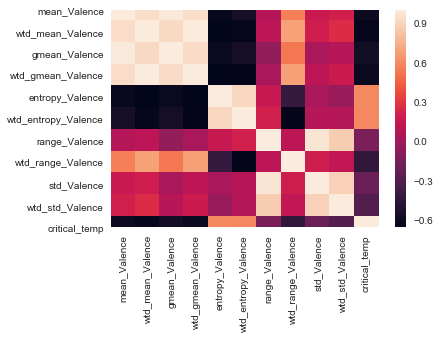

In [22]:
sns.heatmap(pd.concat([valence, critical_temp], axis = 1).corr(),
           xticklabels = pd.concat([valence, critical_temp], axis = 1).columns,
           yticklabels = pd.concat([valence, critical_temp], axis = 1).columns)

In [23]:
pd.concat([valence, critical_temp], axis = 1).corr()

,mean_Valence,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp
mean_Valence,1.000000,0.937103,0.989911,0.940001,-0.619428,-0.558969,0.085892,0.554338,0.164058,0.203341,-0.600085
wtd_mean_Valence,0.937103,1.000000,0.917905,0.994939,-0.652105,-0.636286,0.111249,0.683700,0.186270,0.258593,-0.632401
gmean_Valence,0.989911,0.917905,1.000000,0.933036,-0.615971,-0.563527,-0.041651,0.532805,0.034589,0.088388,-0.573068
wtd_gmean_Valence,0.940001,0.994939,0.933036,1.000000,-0.656235,-0.648708,0.033007,0.681415,0.108469,0.168962,-0.615653
entropy_Valence,-0.619428,-0.652105,-0.615971,-0.656235,1.000000,0.910822,0.155410,-0.417283,0.034580,-0.017031,0.598591
wtd_entropy_Valence,-0.558969,-0.636286,-0.563527,-0.648708,0.910822,1.000000,0.204411,-0.639818,0.089774,0.081284,0.589664
range_Valence,0.085892,0.111249,-0.041651,0.033007,0.155410,0.204411,1.000000,0.114000,0.973788,0.867393,-0.143546
wtd_range_Valence,0.554338,0.683700,0.532805,0.681415,-0.417283,-0.639818,0.114000,1.000000,0.184380,0.132162,-0.439901
std_Valence,0.164058,0.186270,0.034589,0.108469,0.034580,0.089774,0.973788,0.184380,1.000000,0.885856,-0.208072
wtd_std_Valence,0.203341,0.258593,0.088388,0.168962,-0.017031,0.081284,0.867393,0.132162,0.885856,1.000000,-0.300028


## Q: Which elements prevalent in group of lower elements?

In [24]:
combo = pd.concat([df, elements.iloc[:,:-2]], axis = 1)
combo

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,4,106.957877,53.095769,82.515384,43.135565,1.177145,1.254119,146.88130,15.504479,65.764081,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21259,5,92.266740,49.021367,64.812662,32.867748,1.323287,1.571630,188.38390,7.353333,69.232655,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0,0
21260,2,99.663190,95.609104,99.433882,95.464320,0.690847,0.530198,13.51362,53.041104,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21261,2,99.663190,97.095602,99.433882,96.901083,0.690847,0.640883,13.51362,31.115202,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [25]:
low = combo[combo['number_of_elements'] <= 3]
low

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
462,3,72.816957,57.143683,52.075936,35.595823,0.838545,0.845925,122.90607,30.051184,50.602625,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
556,3,72.816957,57.907791,52.075936,36.128407,0.838545,0.840863,122.90607,30.609277,50.602625,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
668,3,72.816957,57.907791,52.075936,36.128407,0.838545,0.840863,122.90607,30.609277,50.602625,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
683,3,39.633467,35.732079,22.005876,24.308416,0.608731,0.666171,89.01900,23.829000,40.000187,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
874,3,72.816957,57.907791,52.075936,36.128407,0.838545,0.840863,122.90607,30.609277,50.602625,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21256,3,89.389833,89.389833,63.694713,63.694713,0.782574,0.782574,164.13150,54.710500,73.156893,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21257,3,89.389833,89.389833,63.694713,63.694713,0.782574,0.782574,164.13150,54.710500,73.156893,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21260,2,99.663190,95.609104,99.433882,95.464320,0.690847,0.530198,13.51362,53.041104,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21261,2,99.663190,97.095602,99.433882,96.901083,0.690847,0.640883,13.51362,31.115202,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [26]:
low_elements = low.iloc[:, 82:168]
low_elements.sum(axis=0).sort_values(ascending=False)

Nb    7857.6980
Zr    7543.8085
C     6451.6954
V     4722.0736
Si    3319.2295
        ...    
Xe       0.0000
At       0.0000
Po       0.0000
He       0.0000
Rn       0.0000
Length: 86, dtype: float64

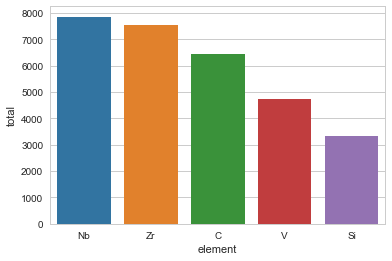

In [27]:
low_element = list(low_elements.sum(axis=0).sort_values(ascending=False).index)
low_total = list(low_elements.sum(axis=0).sort_values(ascending=False).values)

lowDf = pd.DataFrame({'element': low_element, 'total': low_total})
top_lowDf = lowDf.head(5)
sns.barplot(x = "element", y = "total", data = top_lowDf)

## Q: Are these elements consistent for materials with more elements?

In [28]:
med = combo[(combo['number_of_elements'] > 3) & (combo['number_of_elements'] <= 6)]
med

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21246,5,70.406250,43.096221,59.725961,31.931306,1.497519,1.466096,79.96060,11.170606,29.321360,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21253,4,99.290200,85.845160,62.256121,54.519504,1.037993,1.122529,192.98100,38.596200,79.302066,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0
21254,4,99.290200,85.845160,62.256121,54.519504,1.037993,1.122529,192.98100,38.596200,79.302066,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0
21258,4,106.957877,53.095769,82.515384,43.135565,1.177145,1.254119,146.88130,15.504479,65.764081,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [29]:
med_elements = med.iloc[:, 82:168]
med_elements.sum(axis=0).sort_values(ascending=False)

O     58231.7748
Cu    24205.6006
Ba    11192.1720
Sr     5403.5044
Ca     4501.3656
         ...    
At        0.0000
Xe        0.0000
Pm        0.0000
Po        0.0000
Tc        0.0000
Length: 86, dtype: float64

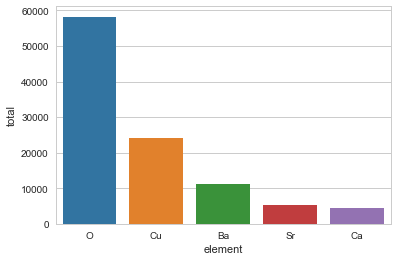

In [30]:
med_element = list(med_elements.sum(axis=0).sort_values(ascending=False).index)
med_total = list(med_elements.sum(axis=0).sort_values(ascending=False).values)


medDf = pd.DataFrame({'element': med_element, 'total': med_total})
top_medDf = medDf.head(5)
sns.barplot(x = "element", y = "total", data = top_medDf)

In [31]:
high = combo[combo['number_of_elements'] > 6]
high

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
473,7,106.454829,80.248218,78.774541,60.495557,1.709748,1.610293,192.98100,26.627491,71.393594,...,0.0,0.0,0.0,0.0,0.0,0.2,0.8,0,0,0
974,7,106.454829,87.091608,78.774541,67.926538,1.709748,1.518523,192.98100,34.309068,71.393594,...,0.0,0.0,0.0,0.0,0.0,0.2,1.7,0,0,0
975,7,106.454829,87.073804,78.774541,67.920726,1.709748,1.563909,192.98100,32.219264,71.393594,...,0.0,0.0,0.0,0.0,0.0,0.3,1.6,0,0,0
976,7,106.454829,87.056000,78.774541,67.914915,1.709748,1.599725,192.98100,30.129460,71.393594,...,0.0,0.0,0.0,0.0,0.0,0.4,1.5,0,0,0
977,7,106.454829,87.038196,78.774541,67.909105,1.709748,1.627938,192.98100,28.039656,71.393594,...,0.0,0.0,0.0,0.0,0.0,0.5,1.4,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21235,7,64.073395,71.374207,50.714667,55.419436,1.752162,1.231657,122.90607,34.310431,39.330466,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21236,7,64.073395,70.874211,50.714667,55.172697,1.752162,1.285364,122.90607,32.921377,39.330466,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21237,7,64.073395,70.249216,50.714667,54.865817,1.752162,1.336901,122.90607,31.185058,39.330466,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21238,7,64.073395,68.999225,50.714667,54.257168,1.752162,1.416413,122.90607,27.712421,39.330466,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [32]:
high_elements = high.iloc[:, 82:168]
high_elements.sum(axis=0).sort_values(ascending=False)

O     4312.1484
Cu    2082.2360
Sr    1353.8130
Ca     782.0870
Bi     581.3200
        ...    
At       0.0000
Zr       0.0000
Rb       0.0000
Kr       0.0000
Tc       0.0000
Length: 86, dtype: float64

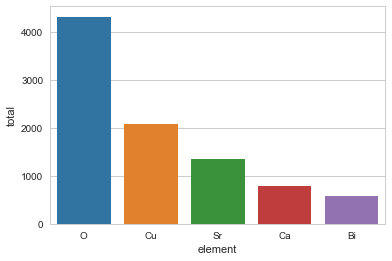

In [33]:
high_element = list(high_elements.sum(axis=0).sort_values(ascending=False).index)
high_total = list(high_elements.sum(axis=0).sort_values(ascending=False).values)


highDf = pd.DataFrame({'element': high_element, 'total': high_total})
top_highDf = highDf.head(5)
sns.barplot(x = "element", y = "total", data = top_highDf)

In [34]:
combo

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,4,106.957877,53.095769,82.515384,43.135565,1.177145,1.254119,146.88130,15.504479,65.764081,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21259,5,92.266740,49.021367,64.812662,32.867748,1.323287,1.571630,188.38390,7.353333,69.232655,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0,0
21260,2,99.663190,95.609104,99.433882,95.464320,0.690847,0.530198,13.51362,53.041104,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21261,2,99.663190,97.095602,99.433882,96.901083,0.690847,0.640883,13.51362,31.115202,6.756810,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


## Q: Which elements are prevalent at different levels of temperature

In [35]:
combo['temp_transformed'] = np.cbrt(df.critical_temp)

In [36]:
combo = combo.sort_values('temp_transformed').reset_index()
lowTemps = combo.iloc[0:7086,:]
medTemps = combo.iloc[7086:14173, :]
highTemps = combo.iloc[14173:len(combo),:]

In [37]:
lowTemps_Elements = lowTemps.iloc[:, 83:169]
lowTemps_Elements.sum(axis=0).sort_values(ascending=False)

Zr    7181.64400
Nb    4201.23200
Si    3596.68800
O     3393.45110
Ti    3019.35965
         ...    
Xe       0.00000
Pm       0.00000
Po       0.00000
He       0.00000
Rn       0.00000
Length: 86, dtype: float64

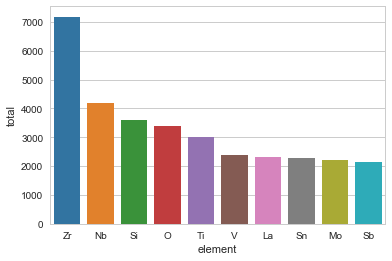

In [38]:
lowTemp_element = list(lowTemps_Elements.sum(axis=0).sort_values(ascending=False).index)
lowTemp_total = list(lowTemps_Elements.sum(axis=0).sort_values(ascending=False).values)


lowTempDf = pd.DataFrame({'element': lowTemp_element, 'total': lowTemp_total})
top_lowTempDf = lowTempDf.head(10)
sns.barplot(x = "element", y = "total", data = top_lowTempDf)

In [39]:
medTemps_Elements = medTemps.iloc[:, 83:169]
medTemps_Elements.sum(axis=0).sort_values(ascending=False)

O     18268.1924
Cu     6009.5388
C      5663.7014
Nb     5195.8410
La     2721.1247
         ...    
Xe        0.0000
At        0.0000
Ar        0.0000
Kr        0.0000
Rn        0.0000
Length: 86, dtype: float64

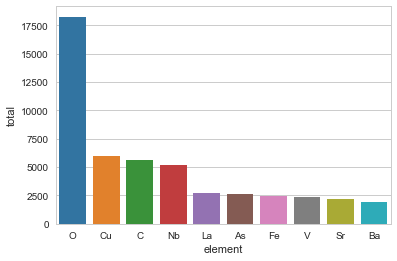

In [40]:
medTemp_element = list(medTemps_Elements.sum(axis=0).sort_values(ascending=False).index)
medTemp_total = list(medTemps_Elements.sum(axis=0).sort_values(ascending=False).values)


medTempDf = pd.DataFrame({'element': medTemp_element, 'total': medTemp_total})
top_medTempDf = medTempDf.head(10)
sns.barplot(x = "element", y = "total", data = top_medTempDf)

In [41]:
highTemps_Elements = highTemps.iloc[:, 83:169]
highTemps_Elements.sum(axis=0).sort_values(ascending=False)

O     42321.4672
Cu    19658.7212
Ba     9544.9300
Sr     4309.9950
Ca     3886.6060
         ...    
Ta        0.0000
Os        0.0000
Ir        0.0000
Po        0.0000
Tc        0.0000
Length: 86, dtype: float64

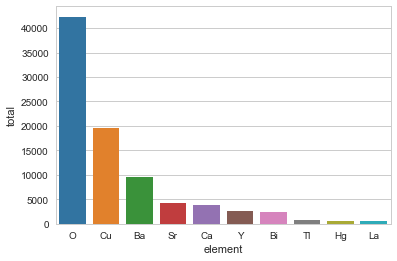

In [42]:
highTemp_element = list(highTemps_Elements.sum(axis=0).sort_values(ascending=False).index)
highTemp_total = list(highTemps_Elements.sum(axis=0).sort_values(ascending=False).values)


highTempDf = pd.DataFrame({'element': highTemp_element, 'total': highTemp_total})
top_highTempDf = highTempDf.head(10)
sns.barplot(x = "element", y = "total", data = top_highTempDf)

## Q: Which elements are most correlated to critical temperature?

In [43]:
just_elements = elements.iloc[:,0:-2]
just_elements

,H,He,Li,Be,B,C,N,O,F,Ne,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
1,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
2,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
3,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
4,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21259,0.0,0,0.0,0.0,0.0,0.0,0.0,11.0,0.0,0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0,0
21260,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
21261,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [44]:
correlations = []

for i in range(0, len(just_elements.columns)):
    correlations.append(just_elements.iloc[:,i].corr(elements['critical_temp']))

                        

In [45]:
correlation_df = pd.DataFrame({'element':just_elements.columns, 'corr':correlations})
correlation_df['abs_corr'] = abs(correlation_df['corr'])
correlation_df = correlation_df.sort_values(by = 'abs_corr', ascending = False)
correlation_df.head(10)

,element,corr,abs_corr
7,O,0.566852,0.566852
55,Ba,0.558766,0.558766
28,Cu,0.518620,0.518620
19,Ca,0.302206,0.302206
37,Sr,0.271127,0.271127
38,Y,0.248097,0.248097
79,Hg,0.218970,0.218970
80,Tl,0.173887,0.173887
82,Bi,0.162499,0.162499
15,S,-0.112922,0.112922


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76]),
 <a list of 77 Text xticklabel objects>)

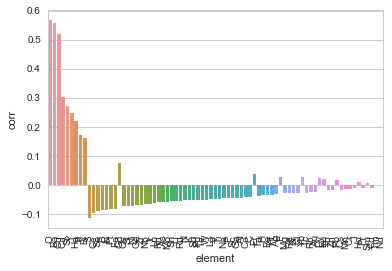

In [46]:
sns.barplot(x = 'element', y = 'corr', data = correlation_df[correlation_df['corr'].notnull()])
plt.xticks(rotation=90)

In [47]:
correlation_df[correlation_df['corr'].isnull()]

,element,corr,abs_corr
1,He,NaN,NaN
9,Ne,NaN,NaN
17,Ar,NaN,NaN
35,Kr,NaN,NaN
53,Xe,NaN,NaN
60,Pm,NaN,NaN
83,Po,NaN,NaN
84,At,NaN,NaN
85,Rn,NaN,NaN


In [48]:
elements.iloc[:,0:-1].corr()

,H,He,Li,Be,B,C,N,O,F,Ne,...,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn,critical_temp
H,1.000000,NaN,0.006903,-0.002702,-0.009035,0.159752,0.083648,-0.022665,-0.001909,NaN,...,-0.007332,-0.001858,-0.011788,-0.011655,-0.007610,-0.017418,NaN,NaN,NaN,-0.034031
He,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Li,0.006903,NaN,1.000000,-0.003714,0.038932,0.011761,0.056727,-0.039966,-0.010366,NaN,...,0.077995,-0.002677,-0.011379,-0.015516,-0.013029,-0.019683,NaN,NaN,NaN,-0.054923
Be,-0.002702,NaN,-0.003714,1.000000,-0.004951,-0.003565,-0.003605,-0.030725,-0.004596,NaN,...,-0.003622,-0.001013,-0.007271,-0.006131,-0.006293,-0.012510,NaN,NaN,NaN,-0.033044
B,-0.009035,NaN,0.038932,-0.004951,1.000000,-0.000572,0.001174,-0.102323,-0.008375,NaN,...,0.007680,-0.003235,-0.024317,-0.024044,-0.020985,-0.041839,NaN,NaN,NaN,-0.086973
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Bi,-0.017418,NaN,-0.019683,-0.012510,-0.041839,-0.025968,-0.024379,0.171170,0.028434,NaN,...,-0.031599,-0.007015,-0.049317,-0.048545,0.067402,1.000000,NaN,NaN,NaN,0.162499
Po,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
At,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Rn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Principal Component Analysis

In [49]:
from sklearn.preprocessing import StandardScaler

In [50]:
X = combo.drop('critical_temp', axis = 1)
X = StandardScaler().fit_transform(X)
X

array([[ 0.67985214, -2.16446082,  0.51718469, ...,  0.        ,
         0.        , -2.25821015],
       [ 0.67968922, -2.16446082,  0.51718469, ...,  0.        ,
         0.        , -2.25053518],
       [ 1.09854852, -2.16446082, -2.71657824, ...,  0.        ,
         0.        , -2.24647515],
       ...,
       [-0.88480158,  1.30954471,  0.78287481, ...,  0.        ,
         0.        ,  2.00180303],
       [-1.08274558,  1.30954471,  0.78287481, ...,  0.        ,
         0.        ,  2.00180303],
       [ 1.61971962, -1.46965972, -2.39323497, ...,  0.        ,
         0.        ,  2.38801266]])

In [51]:
from sklearn.decomposition import PCA
pca = PCA(n_components=66)

In [52]:
principalComponents = pca.fit_transform(X)

In [53]:
pca.explained_variance_ratio_

array([0.21152792, 0.05759016, 0.05411517, 0.04292632, 0.03361547,
       0.02214561, 0.02095855, 0.01830989, 0.0159903 , 0.01504379,
       0.01353491, 0.01282425, 0.01204269, 0.01117524, 0.01100478,
       0.01076363, 0.0103423 , 0.00992063, 0.00970335, 0.00918507,
       0.00910657, 0.00864602, 0.00844847, 0.00819902, 0.00800228,
       0.00786962, 0.0077382 , 0.0075451 , 0.00728138, 0.00716198,
       0.00707334, 0.00692075, 0.00682546, 0.00681157, 0.00666819,
       0.00655785, 0.00651777, 0.00647541, 0.00643107, 0.00640211,
       0.00635727, 0.00633676, 0.00627808, 0.00626951, 0.0062632 ,
       0.00624461, 0.00621543, 0.00618121, 0.00615943, 0.00611772,
       0.00609009, 0.00604608, 0.00595175, 0.00594034, 0.00585061,
       0.00579978, 0.00575583, 0.00557122, 0.0055583 , 0.00541133,
       0.00536893, 0.00520447, 0.00515857, 0.00499309, 0.00487956,
       0.0047824 ])

In [54]:
sum(pca.explained_variance_ratio_)

0.9001877566713671

In [55]:
principalDf = pd.DataFrame(data = principalComponents)
principalDf

,0,1,2,3,4,5,6,7,8,9,...,56,57,58,59,60,61,62,63,64,65
0,15.194208,0.234215,-5.870355,1.617686,-0.387688,-2.652042,-1.705817,1.998846,3.485805,-3.636355,...,-0.348781,-0.370663,0.489113,0.013421,-0.058665,-0.388447,0.627289,-0.408503,-0.003515,-0.917443
1,15.193191,0.233850,-5.870826,1.617215,-0.387358,-2.652501,-1.705982,1.998685,3.485937,-3.635933,...,-0.348829,-0.370562,0.488907,0.013178,-0.058411,-0.388466,0.627778,-0.408448,-0.003633,-0.917689
2,9.543357,2.397743,-9.691925,-5.016263,-4.949700,-2.897473,1.459195,-1.745221,1.045433,-2.814274,...,-0.543839,-0.655086,1.560148,-0.404897,-0.104576,-1.421593,0.889686,1.401811,-0.520752,0.440951
3,11.259621,-3.393735,-1.937075,9.365502,9.208978,-0.466682,-4.546699,-8.988771,-1.208435,-1.138851,...,-1.412545,-2.059470,-0.428654,0.424265,-1.464257,0.681872,-1.141740,-0.806295,0.529493,-2.129081
4,16.834225,-1.364283,-3.865036,8.990074,-0.480278,-1.086255,-2.828513,4.225510,5.018173,-2.101078,...,-0.396907,-0.485029,0.482767,0.626104,-0.329064,-0.687520,0.513754,-1.151981,-1.150961,-1.023067
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,-4.919407,-3.968967,5.146262,-2.301721,-0.168086,-1.592991,-1.143218,-0.829314,-1.647330,-1.860031,...,0.283964,0.184809,-0.270183,0.005052,0.046462,-0.118434,0.377635,0.310559,-0.381519,0.124985
21259,-6.487518,-1.927399,-0.278064,-0.401497,1.037482,-0.387704,1.486583,0.345484,1.518575,0.684785,...,0.167776,0.210326,0.075644,-0.485635,0.090951,0.381432,0.271985,0.151433,-0.308871,-0.237478
21260,-6.712154,-2.023390,0.087484,-0.279534,1.033490,-0.856925,1.491814,0.041909,1.055919,0.640246,...,-0.098273,0.414146,0.187056,-0.366232,0.113858,-0.115815,0.743684,-0.024505,-0.539890,0.004506
21261,-6.778978,-1.957992,0.012630,-0.211742,1.011311,-0.680626,1.568055,0.103959,1.096911,0.525623,...,-0.125533,0.377800,0.205940,-0.368441,0.163578,-0.100538,0.757994,-0.016515,-0.499925,-0.005437


## Preprocessing

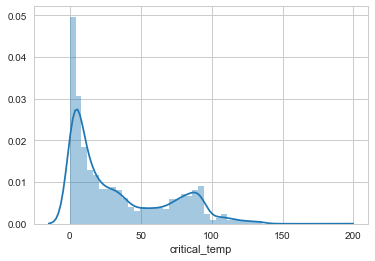

In [56]:
sns.distplot(df.critical_temp)

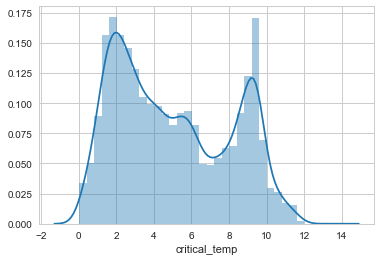

In [57]:
sns.distplot(np.sqrt(df.critical_temp))

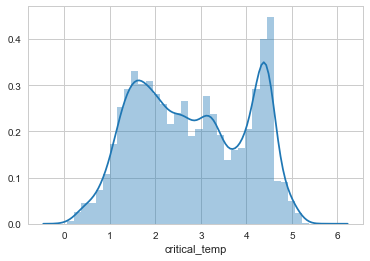

In [58]:
sns.distplot(np.cbrt(df.critical_temp))

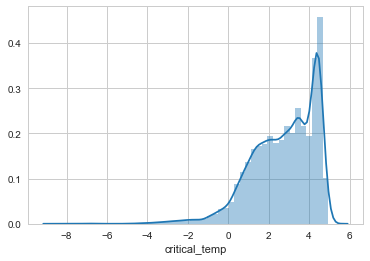

In [59]:
sns.distplot(np.log(df.critical_temp))

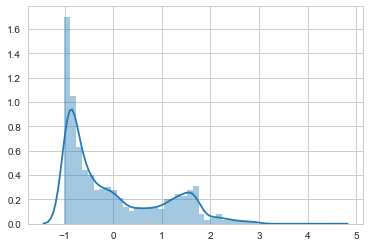

In [60]:
sns.distplot(scipy.stats.zscore(df.critical_temp))

## Model Fitting

In [91]:
cols = ['wtd_entropy_atomic_mass', 'range_fie', 'range_atomic_radius',
        'gmean_Density', 'entropy_ElectronAffinity', 'wtd_entropy_FusionHeat',
       'wtd_std_ThermalConductivity', 'wtd_mean_Valence',
       'O', 'Ba', 'Cu', 'Ca', 'Sr', 'Y', 'Hg', 'Tl', 'Bi', 'S','critical_temp']

subset = combo[cols]
subset

,wtd_entropy_atomic_mass,range_fie,range_atomic_radius,gmean_Density,entropy_ElectronAffinity,wtd_entropy_FusionHeat,wtd_std_ThermalConductivity,wtd_mean_Valence,O,Ba,Cu,Ca,Sr,Y,Hg,Tl,Bi,S,critical_temp
0,0.000000,0.0,0,12450.000000,0.000000,0.000000,0.000000,6.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000210
1,0.000000,0.0,0,12450.000000,0.000000,0.000000,0.000000,6.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000325
2,0.000000,0.0,0,535.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000400
3,0.069126,331.3,18,11877.836503,0.365640,0.035819,34.910633,4.956000,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000500
4,0.000000,0.0,0,21450.000000,0.000000,0.000000,0.000000,6.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000620
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,1.488831,764.1,171,1686.253414,1.617381,1.509487,155.101229,2.670330,1.0,0.0,2.0,2.00,2.0,0.0,0.00,0.0,1.8,0.0,136.000000
21259,1.653117,810.6,205,1495.158598,1.138284,1.261753,152.889250,2.047059,9.0,2.0,3.0,2.00,0.0,0.0,0.20,0.8,0.0,0.0,137.400000
21260,1.676546,810.6,205,1484.236292,1.201034,1.244815,156.202350,2.037500,8.0,2.0,3.0,2.00,0.0,0.0,0.70,0.0,0.0,0.0,143.000000
21261,1.685378,810.6,205,1484.236292,1.201034,1.260352,153.814905,2.041769,8.4,2.0,2.9,1.98,0.0,0.0,0.66,0.0,0.0,0.0,143.000000


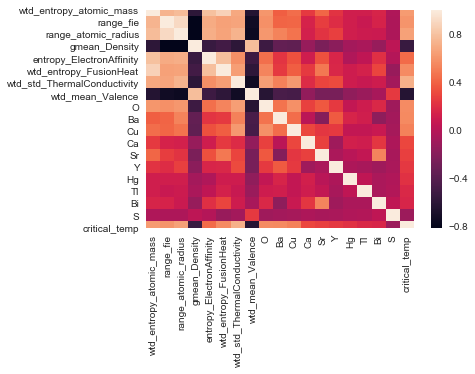

In [62]:
sns.heatmap(subset.corr(),
           xticklabels = subset.columns,
           yticklabels = subset.columns)

In [63]:
subset.corr()

,wtd_entropy_atomic_mass,range_fie,range_atomic_radius,gmean_Density,entropy_ElectronAffinity,wtd_entropy_FusionHeat,wtd_std_ThermalConductivity,wtd_mean_Valence,O,Ba,Cu,Ca,Sr,Y,Hg,Tl,Bi,S,critical_temp
wtd_entropy_atomic_mass,1.000000,0.744625,0.774054,-0.596833,0.796011,0.873931,0.684497,-0.644336,0.602812,0.386289,0.444205,0.250764,0.412043,0.221220,0.120230,0.120345,0.155360,-0.034303,0.626930
range_fie,0.744625,1.000000,0.908734,-0.815491,0.695804,0.657066,0.670738,-0.731329,0.585556,0.404561,0.412738,0.147067,0.267655,0.197326,0.113515,0.084021,0.148581,-0.038418,0.600790
range_atomic_radius,0.774054,0.908734,1.000000,-0.815835,0.711486,0.666575,0.736142,-0.756621,0.616787,0.529546,0.462414,0.129206,0.226707,0.274788,0.115881,0.096601,0.090336,-0.041429,0.653759
gmean_Density,-0.596833,-0.815491,-0.815835,1.000000,-0.545753,-0.501570,-0.601776,0.781497,-0.520980,-0.353042,-0.366710,-0.131891,-0.244928,-0.184413,-0.075137,-0.055841,-0.129492,0.032989,-0.541684
entropy_ElectronAffinity,0.796011,0.695804,0.711486,-0.545753,1.000000,0.790118,0.580221,-0.523597,0.453784,0.233059,0.335247,0.108583,0.338272,0.161378,-0.025263,0.037248,0.207058,-0.013753,0.437207
wtd_entropy_FusionHeat,0.873931,0.657066,0.666575,-0.501570,0.790118,1.000000,0.638352,-0.589524,0.532086,0.251768,0.384942,0.248750,0.482620,0.166820,0.103074,0.139811,0.294931,-0.122757,0.563244
wtd_std_ThermalConductivity,0.684497,0.670738,0.736142,-0.601776,0.580221,0.638352,1.000000,-0.735073,0.642642,0.522832,0.622904,0.185841,0.291526,0.312178,0.099499,0.077773,0.102590,-0.081044,0.721271
wtd_mean_Valence,-0.644336,-0.731329,-0.756621,0.781497,-0.523597,-0.589524,-0.735073,1.000000,-0.625725,-0.463039,-0.481507,-0.153903,-0.257806,-0.255553,-0.156339,-0.116050,-0.061718,0.251105,-0.632401
O,0.602812,0.585556,0.616787,-0.520980,0.453784,0.532086,0.642642,-0.625725,1.000000,0.463560,0.587195,0.281389,0.364949,0.254647,0.054931,0.103098,0.171170,-0.096804,0.566852
Ba,0.386289,0.404561,0.529546,-0.353042,0.233059,0.251768,0.522832,-0.463039,0.463560,1.000000,0.441685,0.015358,-0.210168,0.369485,0.155600,0.117918,-0.166755,-0.078579,0.558766


## Linear Regression

In [64]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression

linearReg = LinearRegression()

In [72]:
full = combo.drop(['critical_temp', 'index', 'temp_transformed'], axis = 1)
full

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,1,102.905500,102.905500,102.905500,102.905500,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.000,0.00,0.0,0.00,0.0,0,0,0
1,1,102.905500,102.905500,102.905500,102.905500,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.000,0.00,0.0,0.00,0.0,0,0,0
2,1,6.941000,6.941000,6.941000,6.941000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.000,0.00,0.0,0.00,0.0,0,0,0
3,2,155.892284,195.159300,150.383867,194.641796,0.658023,0.069126,82.148569,190.107308,41.074284,...,0.0,0.0,0.978,0.00,0.0,0.00,0.0,0,0,0
4,1,195.084000,195.084000,195.084000,195.084000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,1.0,0.000,0.00,0.0,0.00,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21258,7,106.454829,91.018475,78.774541,69.276239,1.709748,1.488831,192.981000,39.998760,71.393594,...,0.0,0.0,0.000,0.00,0.0,0.20,1.8,0,0,0
21259,6,110.320617,52.533367,78.241067,34.005520,1.535695,1.653117,188.383900,13.796235,74.993418,...,0.0,0.0,0.000,0.20,0.8,0.00,0.0,0,0,0
21260,6,110.790067,54.751013,78.419756,35.634607,1.534148,1.676546,191.200600,13.280875,75.587235,...,0.0,0.0,0.000,0.70,0.0,0.30,0.0,0,0,0
21261,6,110.790067,53.779128,78.419756,34.814175,1.534148,1.685378,191.200600,12.543366,75.587235,...,0.0,0.0,0.000,0.66,0.0,0.34,0.0,0,0,0


In [79]:
X = full
y = df['critical_temp']
mse = cross_val_score(linearReg, X, y, scoring = "neg_mean_squared_error", cv = 5)
mean_mse = np.mean(mse)
print(mean_mse)

-1059.8848471511374


In [92]:
X = subset.iloc[:,:-1]
y = df['critical_temp']
mse = cross_val_score(linearReg, X, y, scoring = "neg_mean_squared_error", cv = 5)
mean_mse = np.mean(mse)
print(mean_mse)

-946.213176244062


In [94]:
X = combo.drop('critical_temp', axis = 1)
X = StandardScaler().fit_transform(X)
pca = PCA(n_components=66)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents)

X = principalDf
y = df['critical_temp']
mse = cross_val_score(linearReg, X, y, scoring = "neg_mean_squared_error", cv = 5)
mean_mse = np.mean(mse)
print(mean_mse)

-1114.2661108823663


## Ridge Regression

In [143]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge 

ridge = Ridge()
parameters = {'alpha': [1,10,100,1000,10000]}
ridge_regressor = GridSearchCV(ridge, parameters, scoring = "neg_mean_squared_error", cv = 5)

In [144]:
X = full
y = df['critical_temp']
ridge_regressor.fit(X,y)
print(ridge_regressor.best_params_)
print(ridge_regressor.best_score_)

{'alpha': 10000}
-908.4487001317935


In [145]:
X = subset.iloc[:,:-1]
y = df['critical_temp']
ridge_regressor.fit(X,y)
print(ridge_regressor.best_params_)
print(ridge_regressor.best_score_)

{'alpha': 1000}
-945.5363189760026


In [146]:
X = combo.drop('critical_temp', axis = 1)
X = StandardScaler().fit_transform(X)
pca = PCA(n_components=66)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents)

X = principalDf
y = df['critical_temp']
ridge_regressor.fit(X,y)
print(ridge_regressor.best_params_)
print(ridge_regressor.best_score_)

{'alpha': 10000}
-907.7288996613304


## Lasso Regression

In [155]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso

lasso = Lasso()
parameters = {'alpha': [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]}
lasso_regressor = GridSearchCV(lasso, parameters, scoring = "neg_mean_squared_error", cv = 5)

In [156]:
X = full
y = df['critical_temp']
lasso_regressor.fit(X,y)
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)

{'alpha': 0.4}
-910.9014248312185


In [157]:
X = subset.iloc[:,:-1]
y = df['critical_temp']
lasso_regressor.fit(X,y)
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)

{'alpha': 0.2}
-944.005672635962


In [158]:
X = combo.drop('critical_temp', axis = 1)
X = StandardScaler().fit_transform(X)
pca = PCA(n_components=66)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents)

X = principalDf
y = df['critical_temp']
lasso_regressor.fit(X,y)
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)

{'alpha': 0.2}
-913.4158248697697


## Logistic Regression